## 1. 문제정의

---

전력 사용의 급격한 상승을 완화 시키는 방안으로 비전력냉방시설과 태양광 설비의 사용이 얼마나 효과적인지, 검증하고, 앞으로의 전력량을 예측하려고 한다.

- 폭염기에 비전 냉방시설과 태양광 설비의 설치가 전력사용의 급격한 상승을 완화하는가?
- 효과가 있다면 얼마나 효과가 있는지 수치화 할 수 있는가?

## 2. 분석 목표

---

1. 건물 별 시간(하루, 한 달, 3일 등등) 별 전력 사용량 분석
2. 비전기 냉방시설과 태양광 설비 설치가 주는 영향 분석

### Train set 데이터 형상

In [1]:
import warnings
warnings.filterwarnings("ignore")
import os
from os.path import join
import pandas as pd
import numpy as np
import missingno as msno
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import KFold, cross_val_score
import xgboost as xgb
import lightgbm as lgb
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
file_path_son = 'datathon_energy/'
file_path_hea = '' 

train = pd.read_csv(file_path_son+'train.csv', encoding='cp949')  # 파일 path 바꿔가면서 쓰시면 될 거 같아요
test = pd.read_csv(file_path_son+'test.csv', encoding='cp949')

#train = pd.read_csv('~/_Python/Exploration/data/energy/train.csv', encoding = "cp949")
#test = pd.read_csv('~/_Python/Exploration/data/energy/test.csv', encoding = "cp949")
train.columns = ['num', 'date', 'use_electric', 'temperature', 'wind_speed', 'humidity', 'precipitation', 'sunshine', 'operation', 'solar_power']
train['date']= pd.to_datetime(train['date'])


In [3]:
train.head()

,num,date,use_electric,temperature,wind_speed,humidity,precipitation,sunshine,operation,solar_power
0,1,2020-06-01 00:00:00,8179.056,17.6,2.5,92.0,0.8,0.0,0.0,0.0
1,1,2020-06-01 01:00:00,8135.640,17.7,2.9,91.0,0.3,0.0,0.0,0.0
2,1,2020-06-01 02:00:00,8107.128,17.5,3.2,91.0,0.0,0.0,0.0,0.0
3,1,2020-06-01 03:00:00,8048.808,17.1,3.2,91.0,0.0,0.0,0.0,0.0
4,1,2020-06-01 04:00:00,8043.624,17.0,3.3,92.0,0.0,0.0,0.0,0.0


### 컬럼 추가

In [4]:
# 시간 변수

date = train['date']
train['hour'] = date.dt.hour
train['day'] = date.dt.weekday
train['month'] = date.dt.month
train['week'] = date.dt.weekofyear # 1년 중 몇번째 주
train['dayofyear'] = date.dt.dayofyear  # 1년 중 몇번째 날

# 공휴일 변수 추가

train['holiday'] = train.apply(lambda x : 0 if x['day']<5 else 1, axis = 1)
train['holiday'] = train.loc[('2020-08-17'<=train['date'])&(train['date']<'2020-08-18'), 'holiday'] = 1

# 시간을 sin, cos 함수로

train['sin_time'] = np.sin(2*np.pi*train.hour/24)
train['cos_time'] = np.cos(2*np.pi*train.hour/24)

# THI(temperature-humidity index) : 불쾌지수

train['THI'] = 9/5*train['temperature'] - 0.55*(1-train['humidity']/100)*(9/5*train['humidity']-26)+32

# CDH(Cooling Degree Hour) : 냉방 도일

def CDH(xs):
    ys = []
    for i in range(len(xs)):
        if i < 11:
            ys.append(np.sum(xs[:(i+1)]-26))
        else:
            ys.append(np.sum(xs[(i-11):(i+1)]-26))
    return np.array(ys)

cdhs = np.array([])
for num in range(1,61,1):
    temp = train[train['num'] == num]
    cdh = CDH(temp['temperature'].values)
    cdhs = np.concatenate([cdhs, cdh])
train['CDH'] = cdhs

# 체감 온도

train['body_temperature'] = 13.12 + 0.6215*train['temperature'] - 11.37*(train['wind_speed']*3.6)**0.16 + 0.3965*(train['wind_speed']*3.6)**0.16*train['temperature']

# 화씨로 변형

train['temperature_F'] = (train['temperature'] * 9/5) + 32 

# 열지수

T = train['temperature_F']
RH = train['humidity']
train['heat_index'] = -42.379 + 2.04901523*T + 10.14333127*RH - .22475541*T*RH - .00683783*T*T - .05481717*RH*RH + .00122874*T*T*RH + .00085282*T*RH*RH - .00000199*T*T*RH*RH
train['heat_index'] = (train['heat_index']-32) * 5/9
train.loc[train['heat_index']<32, 'heat_index'] = 0
train.loc[(train['heat_index']>=32) & (train['heat_index']<41), 'heat_index'] = 1
train.loc[(train['heat_index']>=41) & (train['heat_index']<54), 'heat_index'] = 2
train.loc[(train['heat_index']>=54) & (train['heat_index']<66), 'heat_index'] = 3
train.loc[train['heat_index']>=66, 'heat_index'] = 4

# echo_type
train['month_day'] = train['date'].astype(str).str[:10] ## 2020-06-01
train['echo_type'] = train['operation'] + train['solar_power']*2 ##  0: 아무것도 없음 1: operation만 2:solar_system만 3: operation과 solar_system 둘다


- 시간 고려하지 않은 데이터 분포

Text(0, 0.5, 'use_electric')

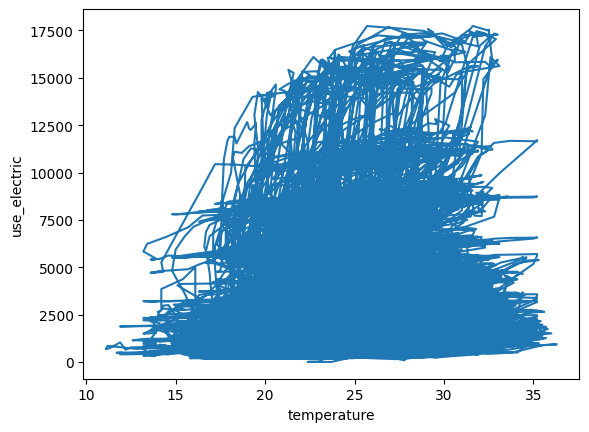

In [5]:
plt.plot(train['temperature'], train['use_electric'])
plt.xlabel('temperature')
plt.ylabel('use_electric')

- date-use_electric 그래프

Text(0, 0.5, 'use_electric')

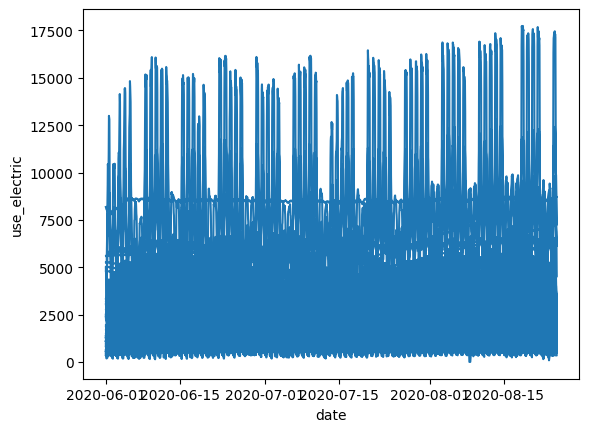

In [6]:
plt.plot(train['date'], train['use_electric'])
plt.xlabel('date')
plt.ylabel('use_electric')

In [7]:
# 3차원 그래프 함수(hue포함)

def draw3D(df, x, y, z, coloraxis = None):
    import plotly.graph_objs as go
    import numpy as np

    # Create some random data
    n = 100
    # Define the color map
    #colorscale = [[0, 'blue'], [1./3, 'green'], [2./3, 'red'], [1, 'blue']]
    colorscale = ['#000000', '#6b0707', '#ec8109', '#ecc509', '#76ec09', '#09a8ec']

    if (coloraxis == None):
        coloraxis = z
    # Create the scatter plot with z-axis colored
    fig = go.Figure(data=[go.Scatter3d(
        x=df[x],
        y=df[y],
        z=df[z],
        mode='markers',
        marker=dict(
            size=2,
            color=df[coloraxis],
            colorscale=colorscale,
            opacity=0.8,
            colorbar=dict(
                title='Z Axis Colorbar Title'
            )
        ),
        hovertemplate='x: %{x}<br>y: %{y}<br>z: %{z}<br>color: %{marker.color}<extra></extra>'
    )])

    # Add axis labels
    fig.update_layout(width=1000, height=800, scene=dict(xaxis_title=x, yaxis_title=y, zaxis_title=z))

    # Show the plot
    fig.show()

In [8]:
_type =[1,9,18,19,21,31,32,33,36,39]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

그래프는 괜찮은데 거슬리는 점들이 있다.

앞으로 이상치 저격수가 해결할 것이다.

## 3.  전처리

### train 데이터 전처리

In [9]:
## 이상치 확인

#1번건물
print(train[(train['num']==1) & (train['use_electric']<=8172) & (train['month_day']=='2020-06-09')].index)
print(train[(train['num']==1) & (train['use_electric']<=7924) & (train['month_day']=='2020-07-14')].index)

# 31번건물
print(train[(train['num']==31) & (train['use_electric']<=2286) & (train['month_day']=='2020-06-11')].index)

print(train[(train['num']==33) & (train['use_electric']<=885) & (train['month_day']=='2020-06-11')].index)

Int64Index([204], dtype='int64')
Int64Index([1033], dtype='int64')
Int64Index([61457], dtype='int64')
Int64Index([65537], dtype='int64')


In [10]:
def interpolate_index(index):
    index_f = index -1
    index_b = index +1
    fb_mean = (train.loc[[index_f],['use_electric']] + train.loc[[index_b], ['use_electric']] )/2
    train.loc[[index],['use_electric']] = fb_mean

In [11]:
# 이상치제거
# x=1, July 14,2020 , z = 7923.744
outline1=[204, 1033, 61457, 65537]
train.loc[[204, 1033, 61457, 65537], ['use_electric']] = np.nan

for i in outline1:
    interpolate_index(i)

### test 데이터 전처리

In [12]:
# test 데이터 전처리
test.columns = ['num', 'date', 'temperature', 'wind_speed', 'humidity', 'precipitation', 'sunshine', 'operation', 'solar_power']
test['date']= pd.to_datetime(train['date'])

In [13]:
# 건물별 비전기냉방성비 운영과 태양광 보유를 판단해 test set의 결측치를 보간합니다.
test_fill = test.copy()
sp_dict = train[['num', 'solar_power']].drop_duplicates().set_index('num').to_dict()['solar_power']
test['solar_power'] = test['num'].map(sp_dict)

op_dict = train[['num', 'operation']].drop_duplicates().set_index('num').to_dict()['operation']
test['operation'] = test['num'].map(op_dict)

In [14]:
test_fill.head()

,num,date,temperature,wind_speed,humidity,precipitation,sunshine,operation,solar_power
0,1,2020-06-01 00:00:00,27.8,1.5,74.0,0.0,0.0,NaN,NaN
1,1,2020-06-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,2020-06-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,2020-06-01 03:00:00,27.3,1.1,78.0,NaN,0.0,NaN,NaN
4,1,2020-06-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [15]:
# temperature 컬럼을 linear interpolation 사용용
test_fill['temperature'] = test_fill['temperature'].interpolate(method='values')

In [16]:
# 'wind_speed', 'humidity' 컬럼 linear interpolation
test_fill['wind_speed'] = test_fill['wind_speed'].interpolate(method='values')
test_fill['humidity'] = test_fill['humidity'].interpolate(method='values')

# 'precipitation', 'sunshine' 컬럼 linear interpolation
test_fill['precipitation'] = test_fill['precipitation'].interpolate(method='values')
test_fill['sunshine'] = test_fill['sunshine'].interpolate(method='values')

In [17]:
test_fill.head(20)

,num,date,temperature,wind_speed,humidity,precipitation,sunshine,operation,solar_power
0,1,2020-06-01 00:00:00,27.800000,1.500000,74.000000,0.0,0.000000,NaN,NaN
1,1,2020-06-01 01:00:00,27.633333,1.366667,75.333333,0.0,0.000000,NaN,NaN
2,1,2020-06-01 02:00:00,27.466667,1.233333,76.666667,0.0,0.000000,NaN,NaN
3,1,2020-06-01 03:00:00,27.300000,1.100000,78.000000,0.0,0.000000,NaN,NaN
4,1,2020-06-01 04:00:00,26.900000,1.166667,79.666667,0.0,0.000000,NaN,NaN
5,1,2020-06-01 05:00:00,26.500000,1.233333,81.333333,0.0,0.000000,NaN,NaN
6,1,2020-06-01 06:00:00,26.100000,1.300000,83.000000,0.0,0.000000,NaN,NaN
7,1,2020-06-01 07:00:00,27.000000,1.266667,81.000000,0.0,0.366667,NaN,NaN
8,1,2020-06-01 08:00:00,27.900000,1.233333,79.000000,0.0,0.733333,NaN,NaN
9,1,2020-06-01 09:00:00,28.800000,1.200000,77.000000,0.0,1.100000,NaN,NaN


### 건물 별 시간별 전력 사용량 그래프 분석

In [18]:
#1. -자형데이터
_type =[1,9,18,19,21,31,32,33,36,39]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

윗 type에 해당하는 건물들 같은 경우 그래프들이 상대적으로 1자 직선 모양에 가깝다 따라서 어느 계절성을 띄는게 아니라 6월에서 8월까지는 일정한 패턴 stational하다고 볼 수 있다.

In [19]:
#2. -자형 산발 데이터
_type =[3,10,28,34,35,39,40,49,50,51,58,59,60]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

위의 빌딩들은 6월에서 7월 중순까지는 1자형과 비슷한 형태를 띈다. 

하지만 7월말 8월부터 전력량이 다소 올라가는 것으로 보인다.

이는 여름에 에어컨 등과 같은 냉방 시설을 이용하는 데에 쓰였을 거라는 생각이듭니다.

In [20]:
# =자형  데이터
_type =[2,6,7,13,16,18,22,25,26,27,37,41,45,46,47,48,52,53,56]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

위의 한자 2자 형태를 띄는 데이터 분포를 가진 빌딩들은 전력량이 높은 부류와 낮은 부류로 군집이 나뉘는 형상을 보인다.

이는 조금 더 분석을 해봐야 알 수 있을 것 같다.

In [21]:
# =자형 산발 데이터 
_type =[8,14,15,23,24,38,29,54,55,57]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

2자형 산발 데이터같은 경우 형세는 2자형과 비슷하지만 여름 시기가 다가올 수록 전력사용량이 커지는 것을 볼 수 있다.

이는 1자형 산발 데이터와 비슷하게 많이 쓰는 시간대엔 많이 쓰고 적게 쓰는 시간대엔 적게 쓰면서 데이터 군집 중 밑 쪽에 위치한 부류들이 더 많이 싸여있는 것으로 얼핏 보인다. 

따라서 이에 따른 2차원 분석이 필요할 것이라 봄.

In [22]:
# 산발 데이터
_type =[4,5,11,12,20,42,43,44]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

위의 산발데이터 같은 경우 진짜 산발이긴 하다.

하지만 얼핏보면 2자형 데이터같이 보이기도 하지만 다소 안정적인 밑 쪽 부류에 비해 윗 쪽 군집이 중구난방이다.

그래서 어떻게 된 건지는 더 알아봐야할 것 같습니다.

In [23]:
# 주말 or 주중 이진 데이터 insert
a=[]
for i in train['day']:
    if i < 5:
        a.append(0)
    else:
        a.append(1)
train['week_end'] = a

In [24]:
# dictionary에 건물별로 데이터 프레임 할당
temp=train
train_dic={}
for i in range(1,61): 
    train_dic[i] = temp[temp['num'] == int('%s'%(i))]
    train_dic[i]['use_electric']=(train_dic[i]['use_electric']-train_dic[i]['use_electric'].mean())/train_dic[i]['use_electric'].std()

In [25]:
# 2차원 그래프 그리기 함수
def graph_5(train_dic,_type,type_len):
    fig,axe = plt.subplots(type_len,1,figsize=[24,36],tight_layout=True)
    for i,x in enumerate(_type):
        sns.lineplot(data = train_dic[x],x='date',y='use_electric',ax=axe[i])

## 2차원 분석

### 1자형

분류 끝

### 1자형 산발

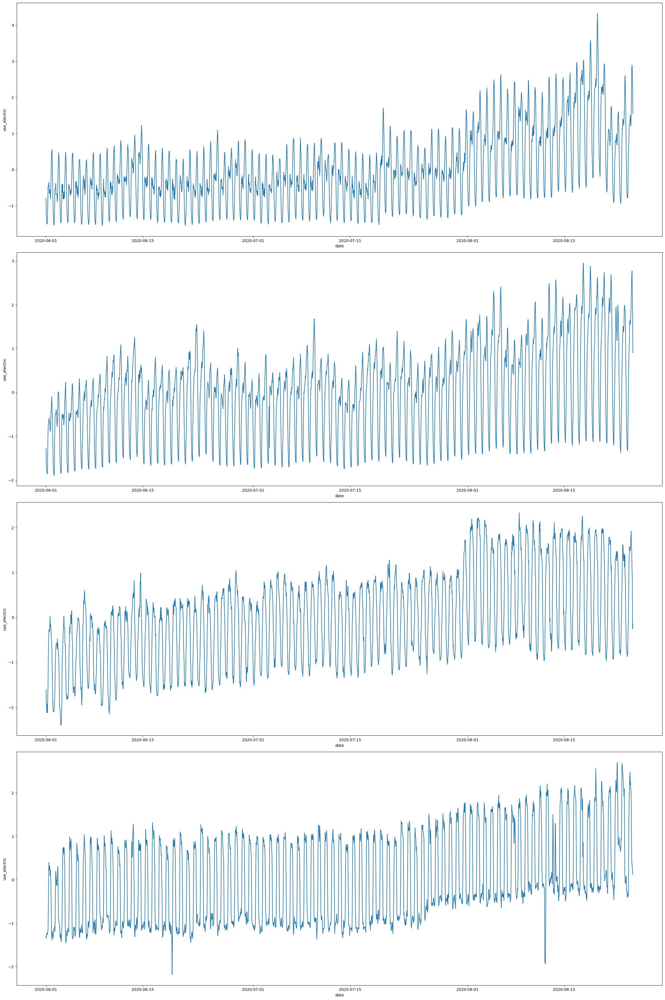

In [26]:
_type =[19,21,28,36]
graph_5(train_dic,_type,len(_type))

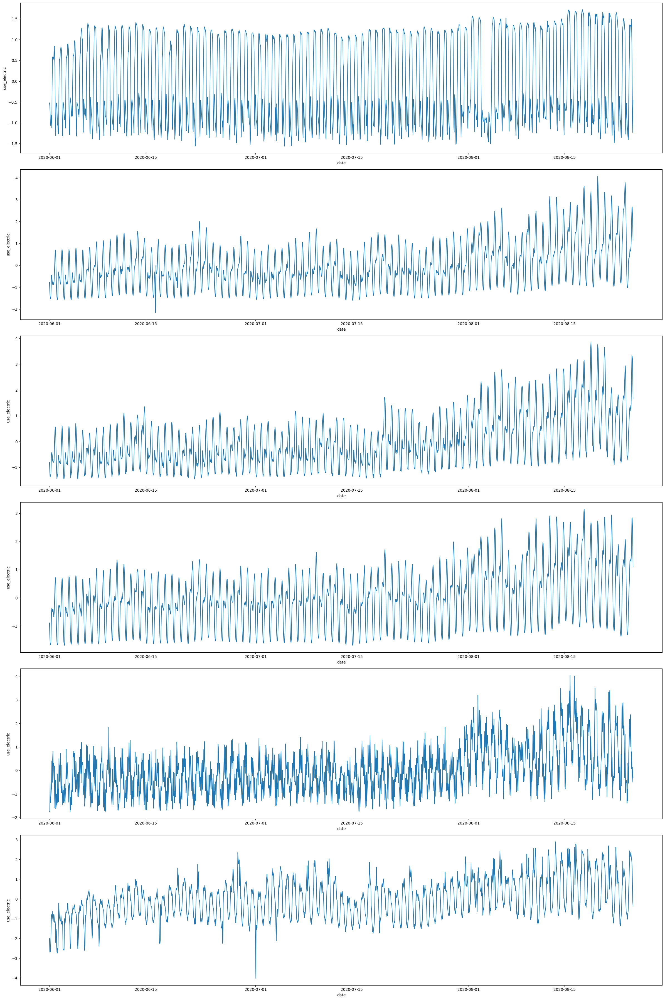

In [27]:
_type=[40,49,50,51,59,60]
graph_5(train_dic,_type,len(_type))

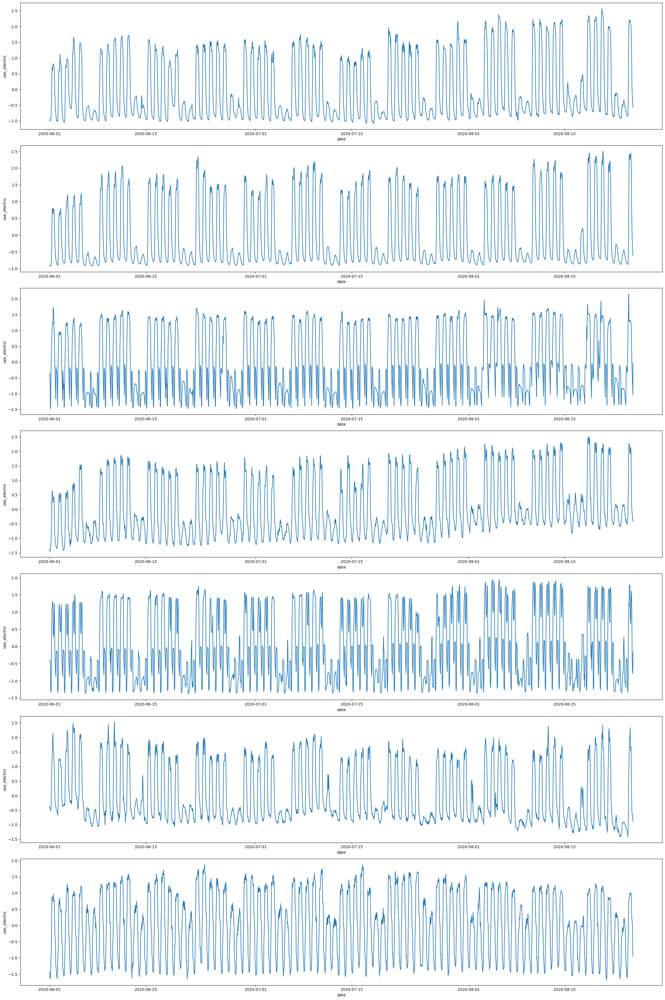

In [28]:
# =자형  데이터
_type =[2,6,7,13,18,33,58]
graph_5(train_dic,_type,len(_type))

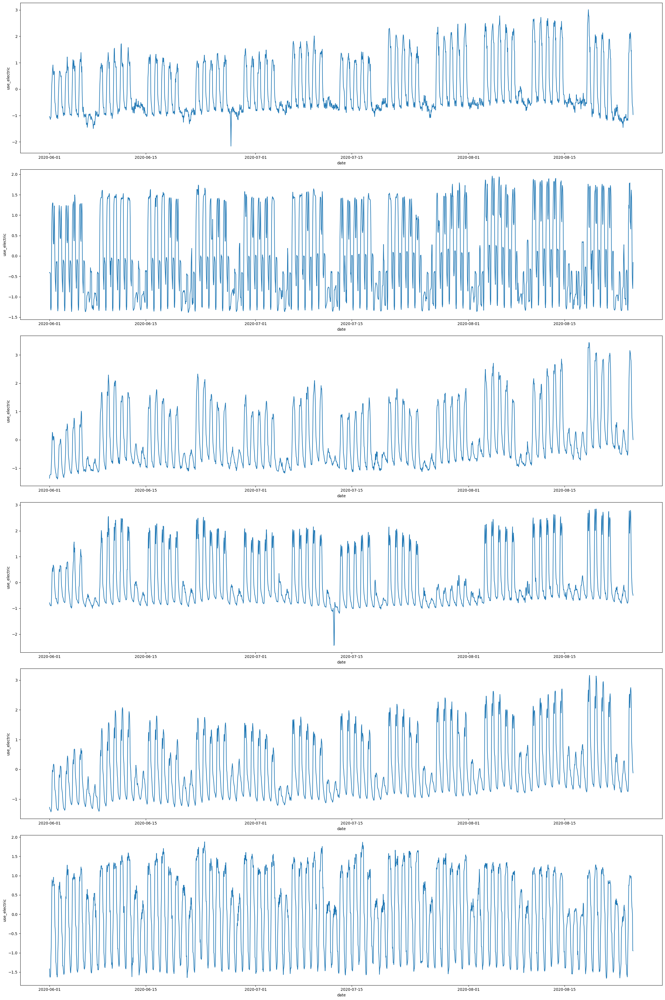

In [29]:
_type =[16,18,22,25,26,58]
graph_5(train_dic,_type,len(_type))

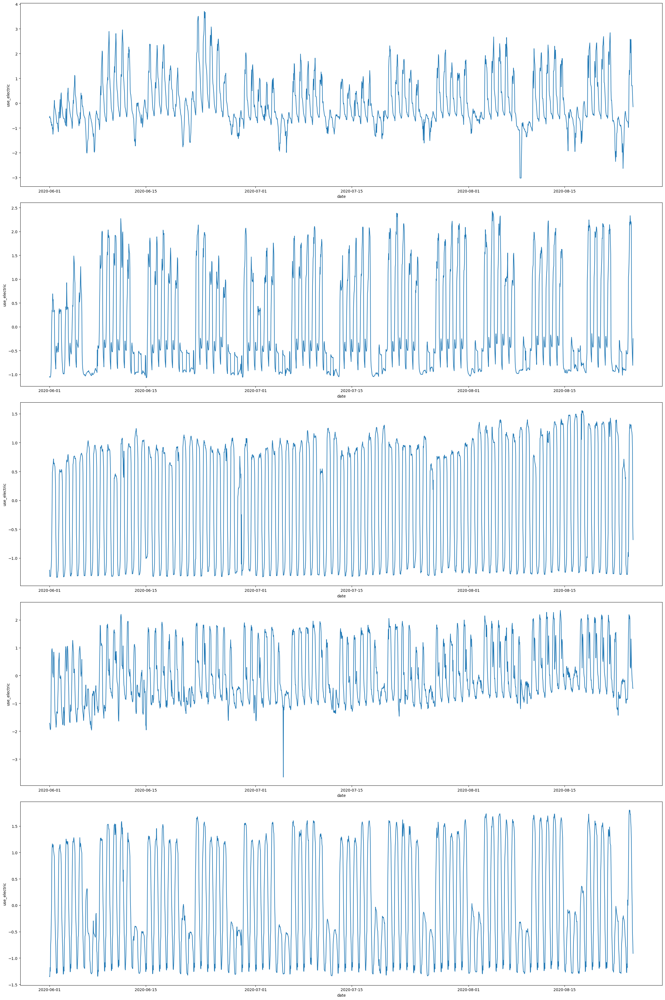

In [30]:
_type =[27,37,41,45,46]
graph_5(train_dic,_type,len(_type))

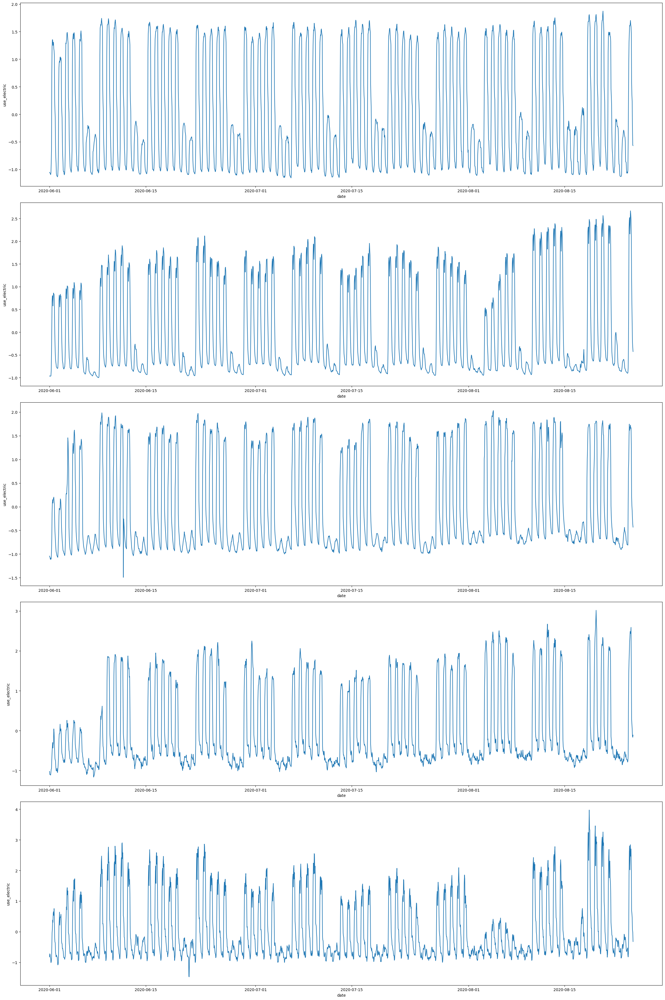

In [31]:
_type =[47,48,52,53,56]
graph_5(train_dic,_type,len(_type))

### 2자형 산발 데이터

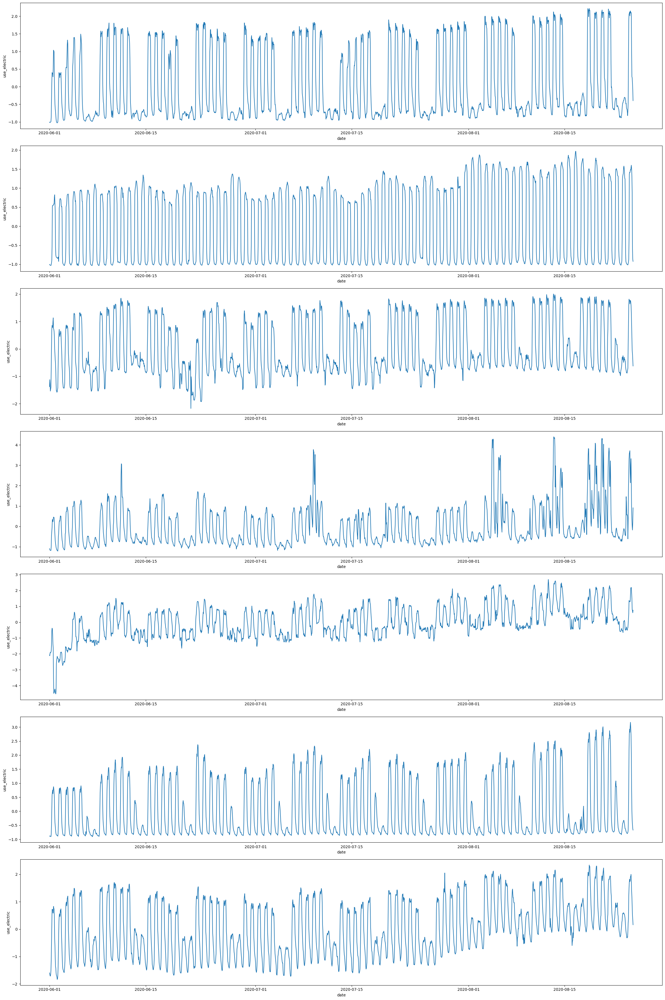

In [32]:
# =자형 산발 데이타
_type =[8,11,14,23,24,35,44]
graph_5(train_dic,_type,len(_type))

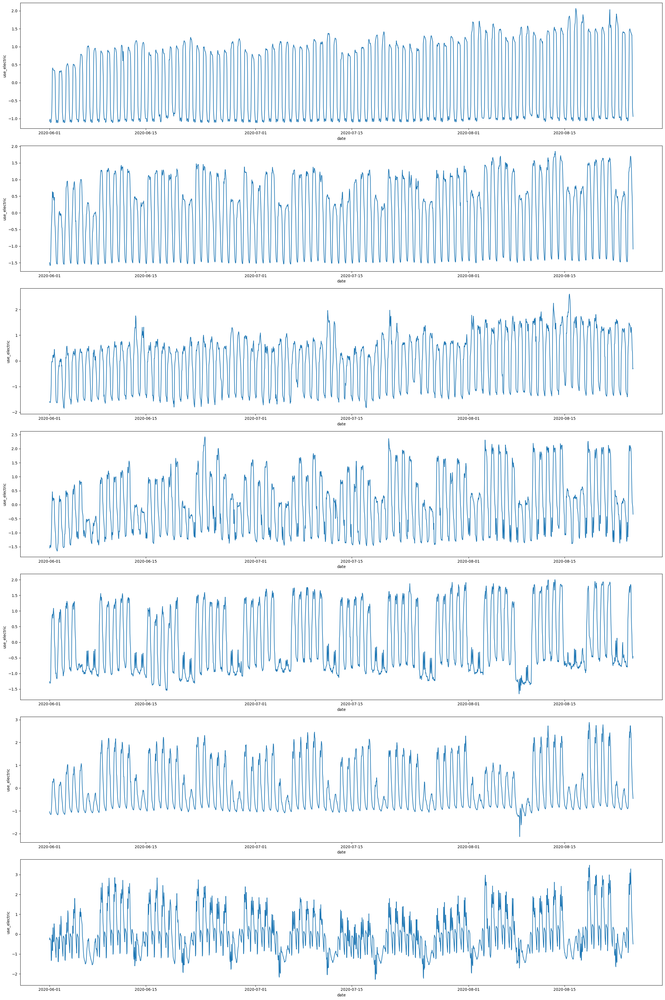

In [33]:
_type = [12,38,29,43,54,55,57]
graph_5(train_dic,_type,len(_type))

### 산발 데이터

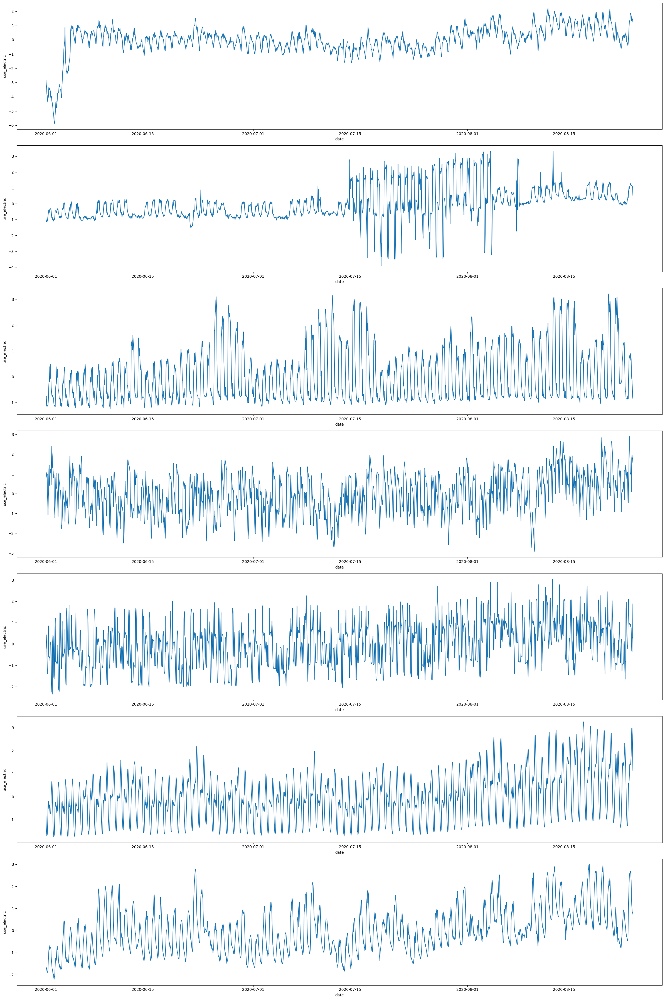

In [34]:
_type =[1,3,4,5,15,20,31]
graph_5(train_dic,_type,len(_type))

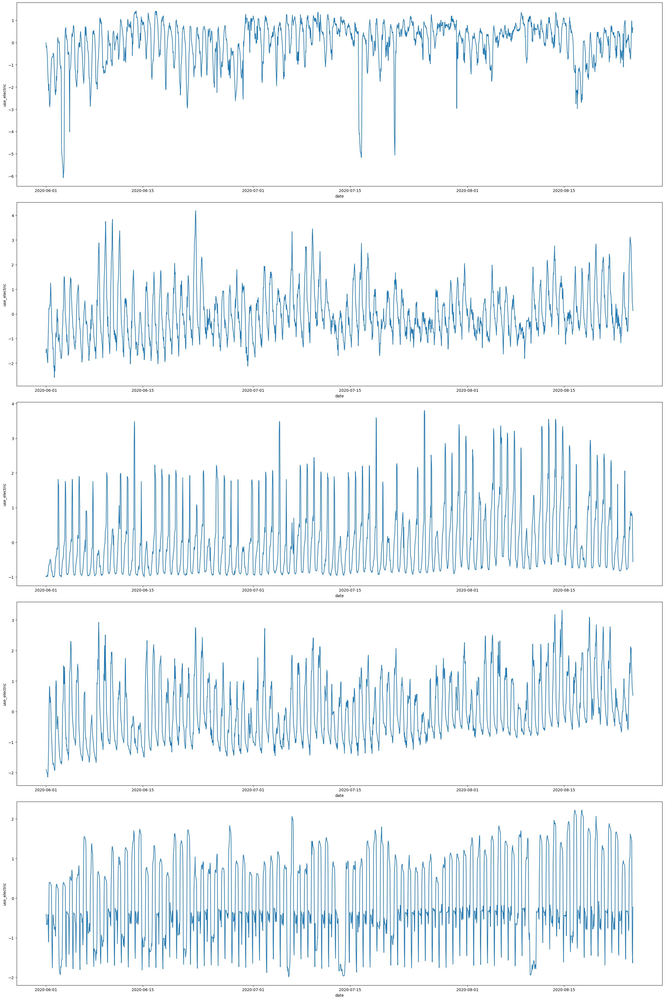

In [35]:
_type =[9,32,34,39,42]
graph_5(train_dic,_type,len(_type))

비전기냉방시설과 태양광 설비의 유무가 전력사용량에 미치는 영향

In [36]:
_type =[11,12,60]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

비전기냉방시설과 태양열전기 설비 시설 모두를 가지고있는 파란색 부류가 전체적인 데이터 값들보다 상위 그룹에 속해있는 것을 볼 수 있다.

물론 직관적으로 에너지공단에 찍히는 전력사용량을 절감시켰을 수는 있다. 하지만 지금의 데이터들 만 보고는 이게 어느정도 줄이는 지를 알기가 
힘들다. 따라서 더 많은 정보를 포함하는 데이터를 얻을 수 있다면 더 자세한 인사이트를 얻을 수 있을 것 같다.

In [37]:
_type =[x for x in range(60)]
display = train[train['num'].isin(_type)==True]
draw3D(display,'num','month_day','use_electric','echo_type')

# 회고

이상치 저격수 : 정혜원

데이터톤 덕분에 새로운 데이터들을 이렇게 심층적으로 분류할 수 있는 좋은 기회가 된 것 같습니다.

그냥 숫자와 불리언 데이터일 뿐인데, 해석하는 사람에 견해에 따라서 많은 의미를 찾을 수 있었습니다.

비슷한 특징을 가지는 건물들끼리 클러스터링을 한 후 비교해보고, 왜 이런 결과가 나왔는지 같이 고민해보는 과정에서 한층 성장할 수 있었습니다.
그리고 pandas 라이브러리랑 조금 더 친해질 수 있었고, 이상치와 결측치를 처리하는 방법에 대해서 공부할 수 있었습니다.

팀원분들 덕분에 주말과 평일의 에너지 사용량이 다른 것을 3차원 그래프를 통해 = 형태로 나타난다는 것 같은 다양한 견해와,

코드와 에러들을 같이 해결해 나가면서 좋은 에너지를 얻고 데이터톤을 잘 마무리 지을 수 있었던 것 같습니다.

3일동안 잠을 줄여가면서 같이 노력하고 도와주신 팀원분들께 정말 감사드리며, 짧은 시간이었지만 정말 값진 시간이었습니다!!


팀장 : 손승우

이번 데이터 분석 EDA 정말 힘들었습니다. 예상치 못하게 예비군 날짜와 겹치면서 오로지 데이터톤에 집중할 수 없는 상황이었습니다.

하지만 갔다와서 팀원들이 했던거 그리고 알아야할 거 서로 소통하고 공유하면서 감사하게도 제가 해야할 걸 오히려 채워주셨던 것 같습니다.

이번에 분석하면서 데이터를 어떻게 바라봐야할 지에 대한 고민을 많이 했던 것 같습니다.

이건 시계열 데이터구나 클러스터 별로 양상이 달라지는 구나하는 중구난방으로 퍼져있는 드래곤볼 같은 점들에서 인사이트를 뽑아내는 데에

많은 시간이 들겠다는 생각이 들었습니다.

그리고 3차원 그래프로 표현하고 얻은 인사이트를 통해 2차원 그래프를 그리고

어느 한 패턴을 얻어가는 과정을 직접 해보면서 데이터를 보고 문제점들을 하나 씩 해결해 나갈 능력을 조금은 키운 것 같습니다.

그리고 팀원들 다시 한번 감사합니다!

3D 프린터 : 박은정

처음 데이타톤을 하게 되서 어리버리하고 뭘해야할지 몰라 그냥 제일 쉬울 것 같은 데이타를 잡았는데, 그건 저의 착각이더군요. 

시계열 60개를 분석하리라고는 생각도 못했습니다.  역시 세상에는 쉬운 일이 없습니다. 

보면 볼 수록 찾고 파고 싶은 것들이 나오는데, 시간도 부족하고 집중력도 떨어지고 뭘했나 싶기도 하네요. 

정신없이 피카추 팀원들과 Git에 대해서도 공부하고, 데이타에 대해 브레인 스토밍도 하고, 막막하지만 하나하나 찾아가며 더듬거리며 
데이타를 만지며 알아가는 느낌이 좋았습니다. 2차원에 그래프와 Dataframe에서만 보던 데이타가 3차원에서 그려지던 모습도 인상적이었고, 
내가 표현하고 싶은 그래프를 이렇게 그릴 수 있어서 재미있었습니다. 

손으로 만져서 구분하라면 이렇게 쉽게 구분이 되는데, 정작 데이타 상에서 clustering 로직을 찾으려니 쉽지가 않더군요.

모델을 학습시키려면 코드를 로직으로 이것을 clustering하는 로직을 짜야 하는데, 아직 나의 실력이 멀었구나 많은 생각을 하게 하는 시간이었습니다. 

늦은 시간에도 졸음 참아가며 저의 말도안되는 상상을 들어주는 승우팀장님과 혜원님에게 진짜 감사드립니다. 

나의 상상이 허공에 흩어지지 않고 그대들에게 닿아 이리 echo로 돌아올 수 있어서 정말 다행이었던 시간이었습니다. 

첫날의 대부분을 Git을 만지작 거리며 보냈던 시간들, 브랜치며, 머지며 혼자서는 해보기 힘들었던 git충돌의 상황을 맞닿드리며 피하지 않고 
해결해 나가던 뚝심의 시간들이 있었고, 처음 3D 모델을 4D표현이 가능하도록 챗 GPT의 도움을 받아 customizing  했던 짜릿한 경험이 있었고, 
3D로 그려졌던 그래프들이 말해주는 의미를 읽으려 고민하던 시간들이 있었고, 나의 한계에 확인하던 시간이 있었습니다. 재미있네요.